In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

In [2]:
DIR2LOAD = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/TNKILC/"
)

In [3]:
DIR2SAVE = DIR2LOAD.joinpath("final/")
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [4]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [5]:
adata_t = sc.read_h5ad(
    DIR2LOAD.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_TNKILC_clustering.h5ad"
    )
)
adata_nk = sc.read_h5ad(
    DIR2LOAD.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_NK_clustering.h5ad")
)

In [6]:
adata_t

AnnData object with n_obs × n_vars = 101060 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'CD8_HSP_score', 'Trm_XCL1_score', 'CD8_Te_GZMK_score', 'CD4_Tn_score', 'CD4_Treg_score', 'Annotation_scVI_detailed', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff'
    var: 'n_cells_by_counts-Che', 'total_counts-Che', 'mean_counts-Che', 'pct_dropout_by_counts-Che', 'n_cells_by_counts-KUL', 'total_counts-KUL', 'mean_counts-KUL', 'pct_dropout_by_counts-KUL', 'n_cells_by_counts-Pelka', 'total_counts-Pelka', 'mean_counts-Pelka', 'pct_dropout_by_counts-Pelka', 'n_cells_by_counts-SMC', 'total_counts-SMC', 'mean_counts-SMC', 'pct_dropout_by_counts-SMC', 'n_cells_by_counts-Wu', 'total_counts-Wu', 'mean_counts-Wu', 'pct_dropout_by_counts-Wu', 'n_cells',

In [7]:
adata_nk.obs

,Patient,Sample,Cell_type,Cell_subtype,Tissue,Therapy,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,cell_source,_scvi_batch,_scvi_labels,leiden_scVI,Annotation_scVI_detailed
SMC01-T_AAGGCAGTCTGCTGTC-SMC,SMC01,SMC01-T,T cells,CD8+ T cells,CRC,naive,0.069909,False,993,2472.0,58.0,2.346278,641.0,25.930420,SMC,0,0,2,NK2
SMC01-T_ACATACGTCATGTCCC-SMC,SMC01,SMC01-T,T cells,NK cells,CRC,naive,0.055182,False,563,1850.0,122.0,6.594594,569.0,30.756756,SMC,0,0,2,NK2
SMC01-T_ACGATGTGTCTGGAGA-SMC,SMC01,SMC01-T,T cells,NK cells,CRC,naive,0.045623,False,651,1396.0,67.0,4.799427,204.0,14.613180,SMC,0,0,1,NKT
SMC01-T_ACTGCTCGTGATGATA-SMC,SMC01,SMC01-T,T cells,NK cells,CRC,naive,0.060649,False,1173,3314.0,174.0,5.250453,933.0,28.153288,SMC,0,0,3,NK1
SMC01-T_ACTGTCCGTTTGACAC-SMC,SMC01,SMC01-T,T cells,NK cells,CRC,naive,0.045623,False,596,1428.0,39.0,2.731092,387.0,27.100840,SMC,0,0,1,NKT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P19_Colon_T_TTGATGGAGGACCCAA-1-Wu,Wu2021_P19,P19_Colon_T,NK,GZMB+ NK cells,CRC,NAC,0.025061,False,521,1031.0,35.0,3.394763,211.0,20.465569,Wu,0,0,3,NK1
P19_Colon_T_TTGTTGTTCTCATGCC-1-Wu,Wu2021_P19,P19_Colon_T,CD8,GZMK+ CD8+ T cells,CRC,NAC,0.139579,False,669,1150.0,57.0,4.956522,223.0,19.391304,Wu,0,0,2,NK2
P15_Colon_T_AGGAGGTGTGACCGAA-1-Wu,Wu2021_P15,P15_Colon_T,NK,GZMB+ NK cells,CRC,NAC,0.070968,False,770,1497.0,96.0,6.412826,313.0,20.908484,Wu,0,0,1,NKT
P15_Colon_T_AGGAGGTTCCTCTAAT-1-Wu,Wu2021_P15,P15_Colon_T,NK,GZMB+ NK cells,CRC,NAC,0.197452,False,815,1783.0,92.0,5.159843,396.0,22.209759,Wu,0,0,4,HSP


In [8]:
adata_nk.obs.Annotation_scVI_detailed.value_counts()

NK2    2840
NKT    1449
NK1    1088
HSP     976
Name: Annotation_scVI_detailed, dtype: int64

In [9]:
# add NK annotations to adata_t object by merging
adata_t.obs = adata_t.obs.merge(
    adata_nk.obs[["Annotation_scVI_detailed"]],
    how="left",
    left_index=True,
    right_index=True,
    suffixes=("", "_NK"),
)

In [10]:
adata_t.obs

,Patient,Sample,Cell_type,Cell_subtype,Tissue,Therapy,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,...,Trm_XCL1_score,CD8_Te_GZMK_score,CD4_Tn_score,CD4_Treg_score,Annotation_scVI_detailed,S_score,G2M_score,phase,cell_cycle_diff,Annotation_scVI_detailed_NK
SMC03-T_ATCTACTGTCATGCCG-SMC,SMC03,SMC03-T,Epithelial cells,CMS3,CRC,naive,0.043597,False,402,1110.0,...,0.076110,-0.016716,0.025334,0.143422,CD4 Th HSP,-0.067636,-0.067099,G1,-0.000537,NaN
SMC14-T_CACAGGCCAGACACTT-SMC,SMC14,SMC14-T,Epithelial cells,CMS2,CRC,naive,0.145401,False,1087,1965.0,...,0.197353,0.019614,-0.032252,0.242251,Treg HSP,-0.167812,0.008236,G2M,-0.176048,NaN
SMC01-T_AAACCTGAGAAGGTTT-SMC,SMC01,SMC01-T,T cells,Regulatory T cells,CRC,naive,0.026052,False,1421,3400.0,...,0.250106,0.448913,0.369975,0.820650,Treg,-0.089521,0.092221,G2M,-0.181742,NaN
SMC01-T_AAACCTGAGGTAGCTG-SMC,SMC01,SMC01-T,T cells,Unknown,CRC,naive,0.080725,False,1270,4495.0,...,0.260866,0.418023,0.514314,0.559388,CD4 Th,-0.100857,-0.081618,G1,-0.019239,NaN
SMC01-T_AAACCTGGTCATATCG-SMC,SMC01,SMC01-T,T cells,Regulatory T cells,CRC,naive,0.057851,False,738,1889.0,...,0.127625,0.358782,0.309141,0.529115,Treg,-0.082524,0.010065,G2M,-0.092588,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P17_Colon_T_TTTATGCCACTTCATT-1-Wu,Wu2021_P17,P17_Colon_T,CD4,CD4+ Naive T cells,CRC,naive,0.116822,False,320,618.0,...,0.064462,0.228368,0.100129,0.183096,CD4 Tn,-0.056839,-0.056388,G1,-0.000451,NaN
P17_Colon_T_TTTCACACACACCTGG-1-Wu,Wu2021_P17,P17_Colon_T,CD8,FGFBP2+ GZMB+ CD8+ T cells,CRC,naive,0.074468,False,369,617.0,...,0.125624,0.496340,0.070080,0.182674,CD8 Tem,-0.088863,-0.088158,G1,-0.000705,NaN
P17_Colon_T_TTTCACAGTACGACTT-1-Wu,Wu2021_P17,P17_Colon_T,CD8,XCL1+ CD8+ T cells,CRC,naive,0.124088,False,586,1196.0,...,0.363183,0.265698,0.241333,0.256069,CD4 Th,0.048652,0.089048,G2M,-0.040396,NaN
P17_Colon_T_TTTCATGCACACAGAG-1-Wu,Wu2021_P17,P17_Colon_T,MAIT,MAIT cells,CRC,naive,0.103896,False,582,1100.0,...,0.275450,0.339795,0.197042,0.414662,CD4 Th,-0.048732,-0.109256,G1,0.060524,NaN


Notice that col `Annotation_scVI_detailed_NK` has NaN values for T cell annotation, need to fill the nan with T cell annotations from `Annotation_scVI_detailed`

In [11]:
adata_t.obs.Annotation_scVI_detailed_NK = np.where(
    adata_t.obs.Annotation_scVI_detailed_NK.isna(),  # where NaN values in NK annot
    adata_t.obs.Annotation_scVI_detailed,  # put T annotations
    adata_t.obs.Annotation_scVI_detailed_NK,
)  # keep NK annotations

adata_t.obs.Annotation_scVI_detailed_NK = (
    adata_t.obs.Annotation_scVI_detailed_NK.astype("category")
)

In [12]:
adata_t.obs.Annotation_scVI_detailed_NK

SMC03-T_ATCTACTGTCATGCCG-SMC         CD4 Th HSP
SMC14-T_CACAGGCCAGACACTT-SMC           Treg HSP
SMC01-T_AAACCTGAGAAGGTTT-SMC               Treg
SMC01-T_AAACCTGAGGTAGCTG-SMC             CD4 Th
SMC01-T_AAACCTGGTCATATCG-SMC               Treg
                                        ...    
P17_Colon_T_TTTATGCCACTTCATT-1-Wu        CD4 Tn
P17_Colon_T_TTTCACACACACCTGG-1-Wu       CD8 Tem
P17_Colon_T_TTTCACAGTACGACTT-1-Wu        CD4 Th
P17_Colon_T_TTTCATGCACACAGAG-1-Wu        CD4 Th
P20_Colon_T_CTTCCGAGTACAGTCT-1-Wu            NK
Name: Annotation_scVI_detailed_NK, Length: 101060, dtype: category
Categories (20, object): ['B-T doublet', 'CD4 Tfh', 'CD4 Th', 'CD4 Th HSP', ..., 'T cycling', 'Treg', 'Treg HSP', 'gdT']

### Colour before removal of troubling clusters 

In [13]:
adata_t.obs.Annotation_scVI_detailed_NK.cat.categories.tolist()

['B-T doublet',
 'CD4 Tfh',
 'CD4 Th',
 'CD4 Th HSP',
 'CD4 Th17',
 'CD4 Tn',
 'CD8 Tem',
 'CD8 Tem HSP',
 'CD8 Tex',
 'HSP',
 'ILC3',
 'Myeloid-T doublet',
 'NK',
 'NK1',
 'NK2',
 'NKT',
 'T cycling',
 'Treg',
 'Treg HSP',
 'gdT']

In [14]:
adata_t.uns["Annotation_scVI_detailed_NK_colors"] = [
    "#bc80bd",
    "#1f78b4",
    "#fa9fb5",
    "#beaed4",
    "#fdbf6f",
    "#b15928",
    "#e31a1c",
    "#800026",
    "#ff7f00",
    "#969696",
    "#cab2d6",
    "#80b1d3",
    "#f768a1",
    "#1d91c0",
    "#dd3497",
    "#a6cee3",
    "#ffff99",
    "#33a02c",
    "#b2df8a",
    "#6a3d9a",
]

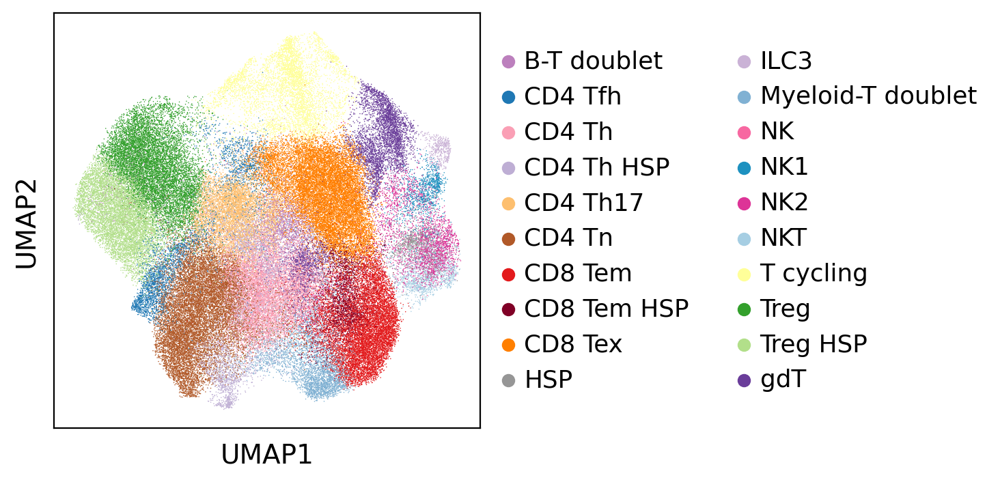

In [15]:
sc.pl.umap(
    adata_t,
    color="Annotation_scVI_detailed_NK",
    title="",
    save="annotations_before_removal_problem_clusters.pdf",
)

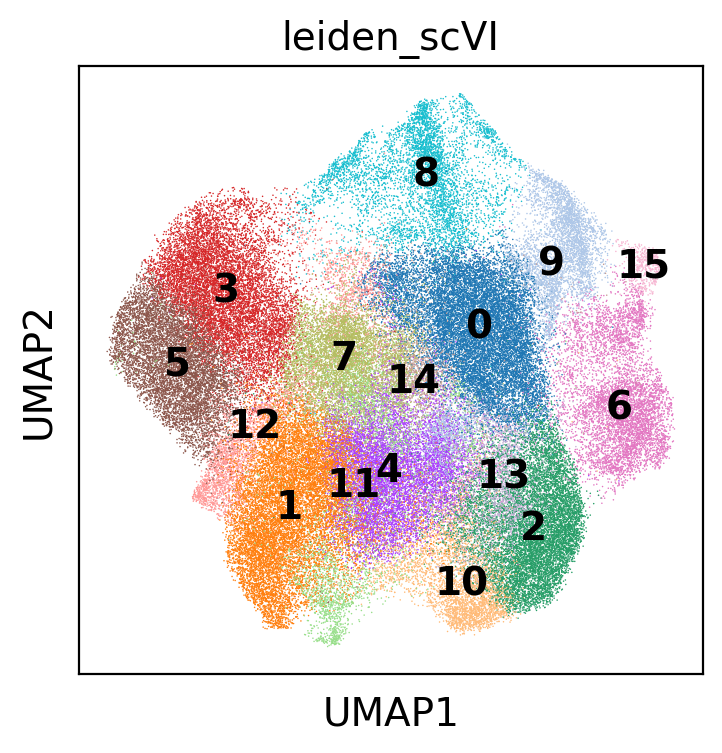

In [16]:
sc.pl.umap(
    adata_t,
    color="leiden_scVI",
    legend_loc="on data",
    save="leiden_before_removal_problem_clusters.pdf",
)

### Remove problem clusters as well as NK cells that were removed from subclustering of NK cells because patients had less than 3 cells

In [17]:
# remove problem columns
adata_t = adata_t[
    ~adata_t.obs.Annotation_scVI_detailed_NK.isin(
        ["B-T doublet", "HSP", "Myeloid-T doublet", "NK"]
    )
].copy()

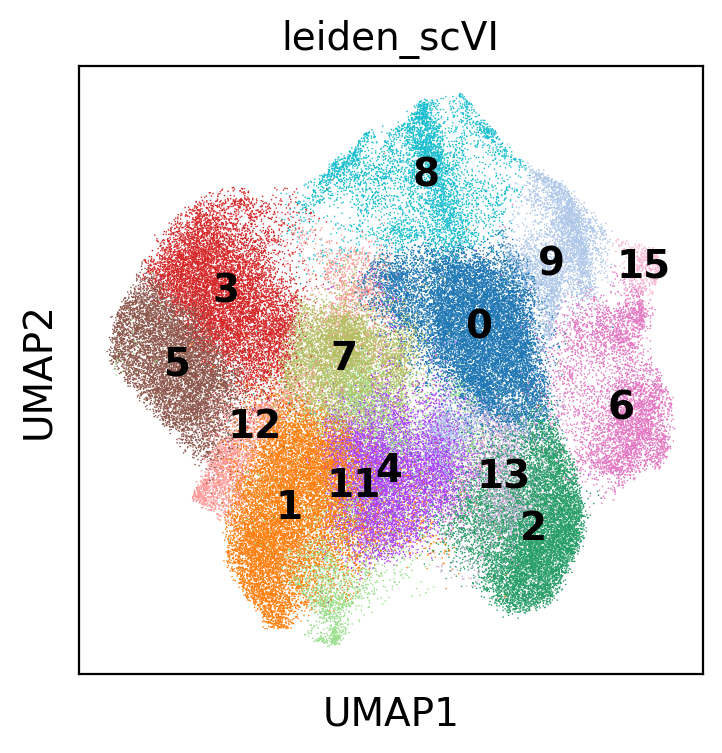

In [18]:
sc.pl.umap(
    adata_t,
    color="leiden_scVI",
    legend_loc="on data",
    save="leiden_after_removal_problem_clusters.pdf",
)

In [19]:
# todo dotplot with all cell types annotated
markers_T_dotplot = {
    "T": ["TRAC"],
    "CD4": ["CD4"],
    "CD8": ["CD8A", "CD8B"],
    "Cycling": ["MKI67"],
    "Treg": ["FOXP3", "CTLA4", "CCR4", "IL2RA"],  # Treg are CD127 (IL7R) low.
    "Exhausted T": [
        "PDCD1",
        "LAG3",
        "HAVCR2",
        "CTLA4",
        "TIGIT",
        "ENTPD1",
    ],  # PD1: PCDC1, TIM3: HAVCR2,  CD39:ENTPD1 https://www.nature.com/articles/s41467-021-23324-4
    "NK": [
        "EOMES",
        "CMC1",
        "GZMK",
        "XCL1",
        "NKG7",
        "PRF1",
        "NCR1",
        "NCAM1",
        "FCER1G",
        "ITGA1",
        "GZMB",
        "FCGR3A",
    ],
    "ILC": ["AREG", "TLE1", "IL4I1"],
    "Th": ["CD4", "TRAC", "CD3D", "TRBC1", "TRBC2"],
    "Tfh": ["ICOS", "CXCR5", "TCF7", "PDCD1", "CCR7"],
    "Naïve CD4 T": ["CCR7", "SELL", "TCF7", "LEF1"],
    "Th17": ["IL17A", "ODF2L", "IL7R", "PDE4D"],
    "Effector CD8": ["CCL4", "CCL5", "GZMK", "GZMB", "PFN1", "GZMA", "GZMH", "NKG7"],
    "gdT": ["KLRC2", "TRGC1", "TRGC2", "TRDC"],
    "ILC3": ["IL4I1", "RORC", "TNFRSF25", "SPINK2", "KLRB1", "IL7R"],
}

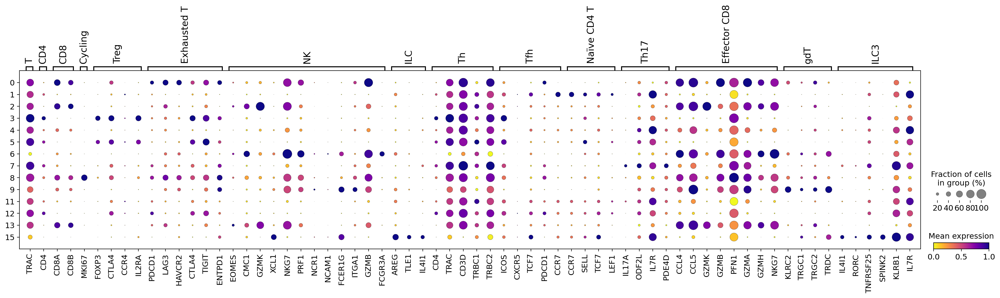

In [20]:
sc.pl.dotplot(
    adata_t,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_T_dotplot,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="TNKILC_annotations_dotplot_mean.pdf",
    show=True,
)

### Change colours to match metastasis

In [21]:
# set colours for dataset, need to know order
adata_t.obs.Annotation_scVI_detailed_NK.cat.categories.values.tolist()

['CD4 Tfh',
 'CD4 Th',
 'CD4 Th HSP',
 'CD4 Th17',
 'CD4 Tn',
 'CD8 Tem',
 'CD8 Tem HSP',
 'CD8 Tex',
 'ILC3',
 'NK1',
 'NK2',
 'NKT',
 'T cycling',
 'Treg',
 'Treg HSP',
 'gdT']

In [22]:
adata_t.uns["Annotation_scVI_detailed_NK_colors"] = [
    "#1f78b4",
    "#fa9fb5",
    "#beaed4",
    "#fdbf6f",
    "#b15928",
    "#e31a1c",
    "#800026",
    "#ff7f00",
    "#cab2d6",
    "#1d91c0",
    "#dd3497",
    "#a6cee3",
    "#ffff99",
    "#33a02c",
    "#b2df8a",
    "#6a3d9a",
]

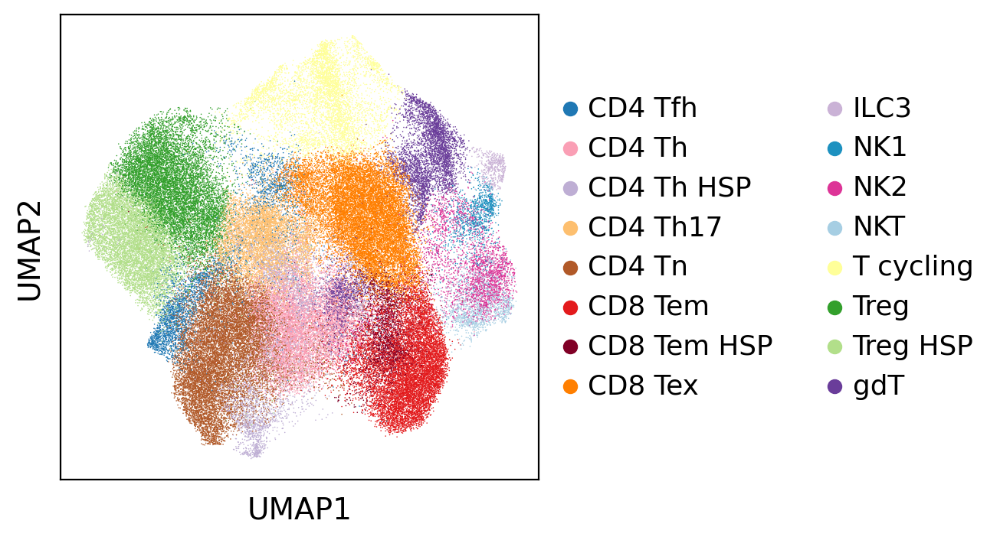

In [23]:
sc.pl.umap(
    adata_t,
    color="Annotation_scVI_detailed_NK",
    save="Annotations.pdf",
    show=True,
    legend_loc="right margin",
    title="",
)

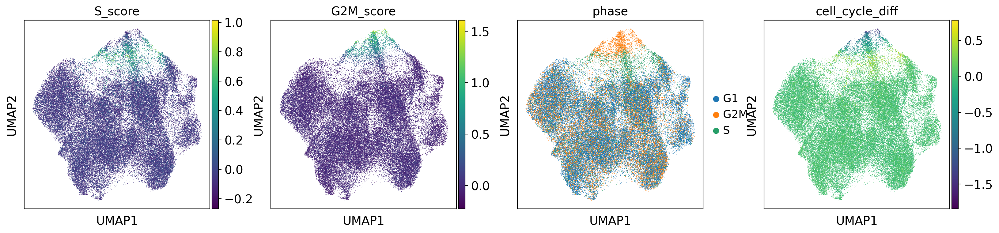

In [24]:
sc.pl.umap(
    adata_t,
    color=["S_score", "G2M_score", "phase", "cell_cycle_diff"],
    color_map="viridis",
    save="cell_cycle.pdf",
)

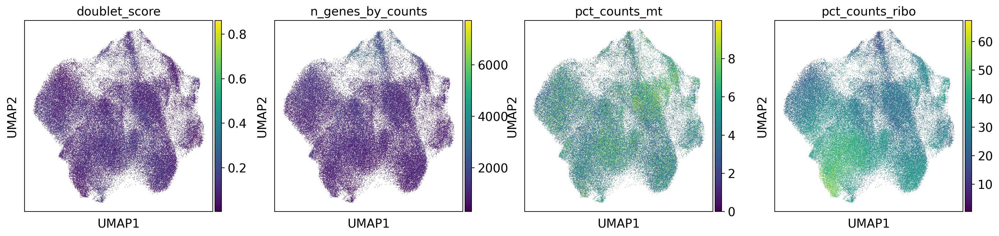

In [25]:
sc.pl.umap(
    adata_t,
    color=["doublet_score", "n_genes_by_counts", "pct_counts_mt", "pct_counts_ribo"],
    color_map="viridis",
    save="QC_covariates.pdf",
)

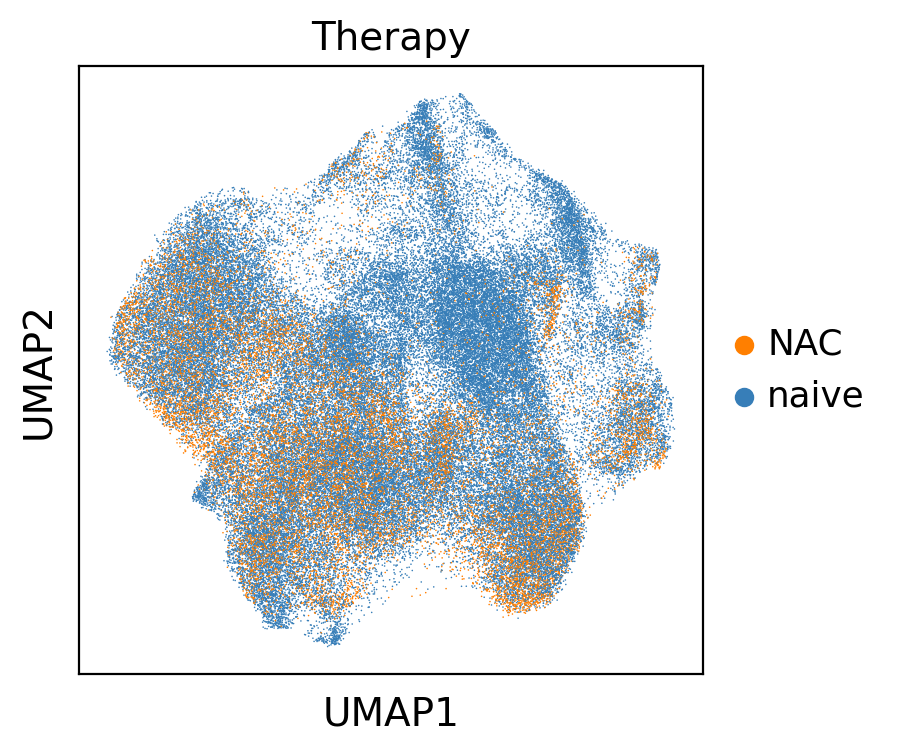

In [26]:
sc.pl.umap(adata_t, color="Therapy", legend_loc="right margin")

### Look at distribution of cell source across clusters 

In [27]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, colors: dict, figname: str
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        sharey=False,
        sharex=False,
        dpi=DPI,
    )  # figsize=(4, 4))

    print(table2plot)
    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())
    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]
    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(FIG2SAVE.joinpath(figname), dpi=DPI, format="pdf", bbox_inches="tight")
    plt.show()

cell_source        SMC       KUL      Pelka        Che         Wu
leiden_scVI                                                      
0            14.001303  0.767393  67.125172  12.727141   5.378991
1            23.207899  2.589022  25.260457  25.610325  23.332297
2            18.788000  2.491777  17.990631  44.303797  16.425795
3            18.313327  2.133990  44.413666  21.524572  13.614445
4             9.119233  3.271420  45.200719  28.208508  14.200120
5            14.633205  3.655084  22.187902  31.724582  27.799228
6            16.087037  1.060071  36.079598  37.753394   9.019900
7            26.337115  1.539708  42.512156  13.225284  16.385737
8             8.850575  0.134100  65.172414  25.038314   0.804598
9            12.007241  0.181014  65.567176  11.343524  10.901046
11           23.566879  0.138466   7.366381  10.495708  58.432567
12           13.919308  2.968300  39.711816  30.144092  13.256484
13           25.411969  0.910668  30.095403  16.261925  27.320035
15        

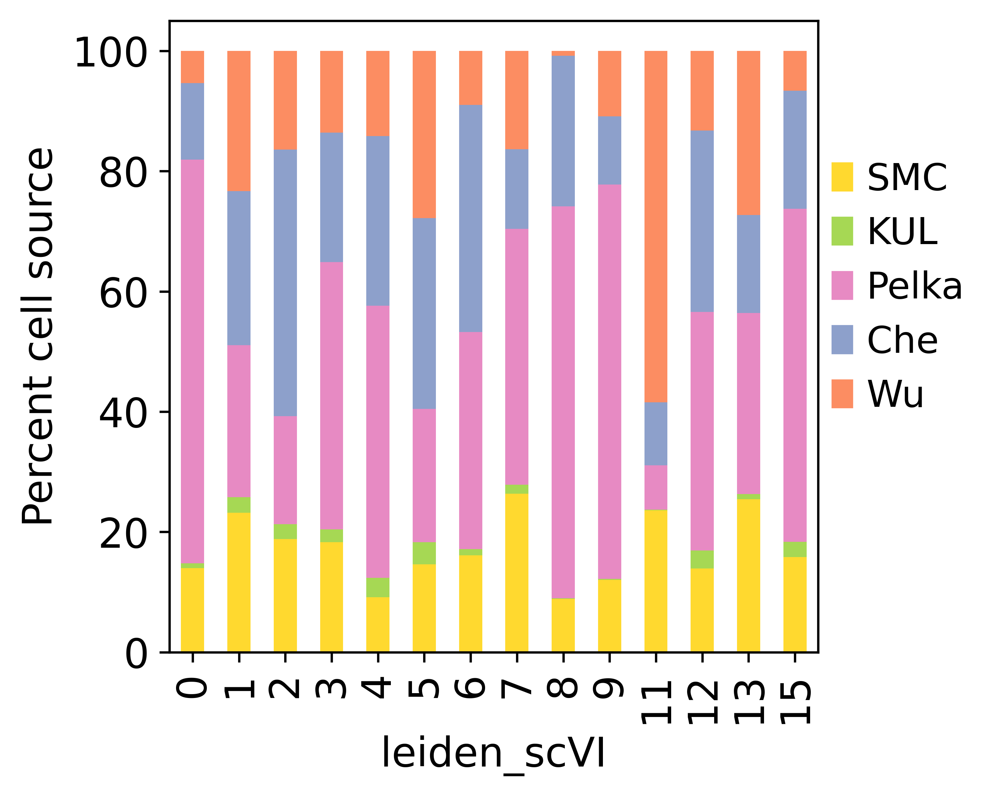

In [28]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata_t.obs["cell_source"].cat.categories.values.tolist(),
        adata_t.uns["cell_source_colors"],
    )
)

proportion_cells_patient(
    adata_t.obs,
    groupby_labels=["leiden_scVI", "cell_source"],
    xlabel="leiden_scVI",
    ylabel="Percent cell source",
    colors=color_dict,
    figname="leiden_cell_source.pdf",
)

---
**T cell populations** GZMB, GZMK differences: GZMB in terminal effector or exhausted, while GZMK in effector memory. see paper *Two subsets of stem-like CD8+ memory T cell progenitors with distinct fate commitments in humans* and notes in zotero 

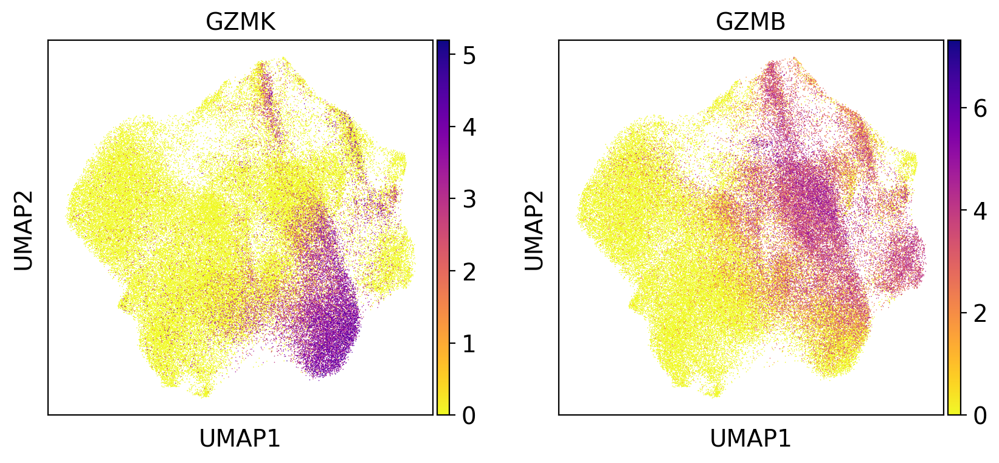

In [29]:
sc.pl.umap(
    adata_t, color=["GZMK", "GZMB"], use_raw=True, color_map="plasma_r", save="GZMB"
)

/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


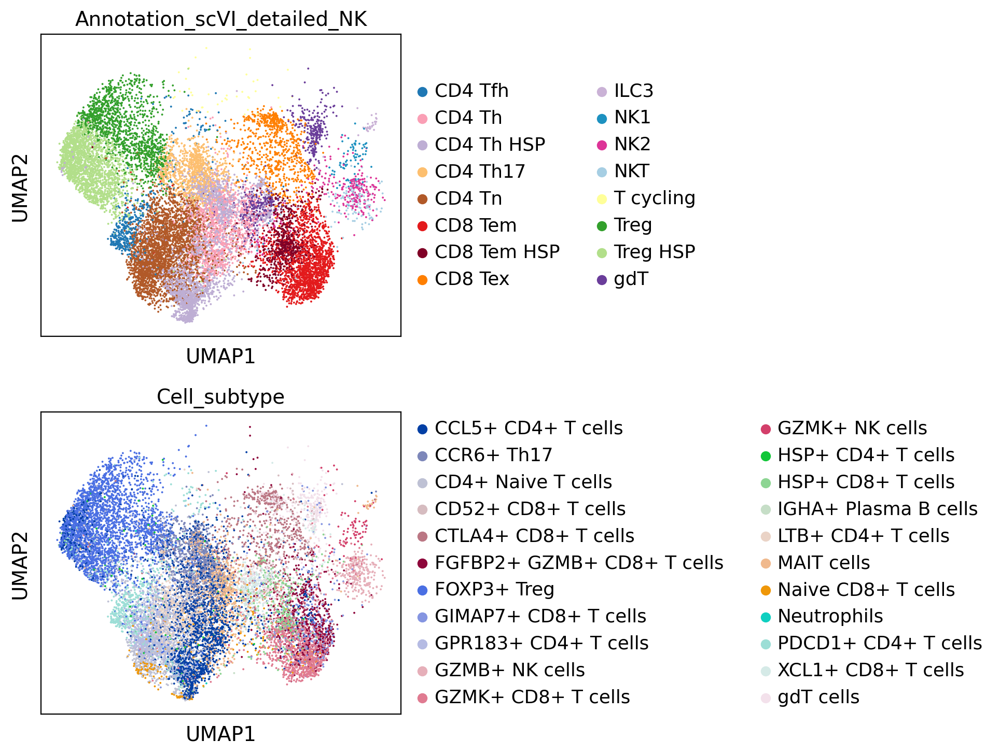

In [30]:
sc.pl.umap(
    adata_t[adata_t.obs.cell_source == "Wu"],
    color=["Annotation_scVI_detailed_NK", "Cell_subtype"],
    use_raw=True,
    ncols=1,
)

--- 
markers 

In [31]:
# todo dotplot with all cell types annotated
markers = {
    "T": ["TRAC"],
    "CD4": ["CD4"],
    "CD8": ["CD8A", "CD8B"],
    "Cycling": ["MKI67"],
    "Treg": ["FOXP3", "CTLA4", "IL2RA"],
    "Exhausted T": [
        "PDCD1",
        "LAG3",
        "HAVCR2",
        "CTLA4",
        "TIGIT",
        "ENTPD1",
    ],  # PD1: PCDC1, TIM3: HAVCR2,  CD39:ENTPD1 https://www.nature.com/articles/s41467-021-23324-4
    "NK": ["NCAM1", "FCER1G", "KLRC1"],
    "ILC": ["AREG", "TLE1", "IL4I1"],
    "Th": ["IL7R", "CD40LG", "ANXA1"],
    "Tfh": ["ITM2A", "LPAR6", "PDCD1"],
    "Naïve CD4 T": ["CCR7", "SELL", "TCF7", "LEF1"],
    "Th17": ["IL17A", "ODF2L", "IL7R", "PDE4D"],
    "Effector memory CD8": ["CCL4", "CCL5", "GZMK", "GZMB"],
    "gdT": ["TRDC", "TRGC1", "ITGA1"],
    "ILC3": ["IL4I1", "RORC", "TNFRSF25", "SPINK2", "KLRB1", "IL7R"],
    "NK2": [
        "ENTPD1",
        "CSF1",
        "KLRC1",
        "KLRC2",
        "TIGIT",
        "CYP26A1",
        "B4GALNT1",
        "CD9",
        "KIR2DL1",
        "KIR2DL3",
        "LILRB1",
        "KLRC3",
        "GZMA",
        "GZMB",
        "GNLY",
        "PRF1",
        "HAVCR2",
        "EOMES",
        "IL2RB",
        "ID3",
    ],  # dNK1
    "NK1": ["ANXA1", "ITGB2", "CD9", "CD7", "EOMES", "XCL1", "SELL", "IFITM3"],  # dNK2
    "NKT": ["KLRB1", "CD3G", "FGFBP2"],
}

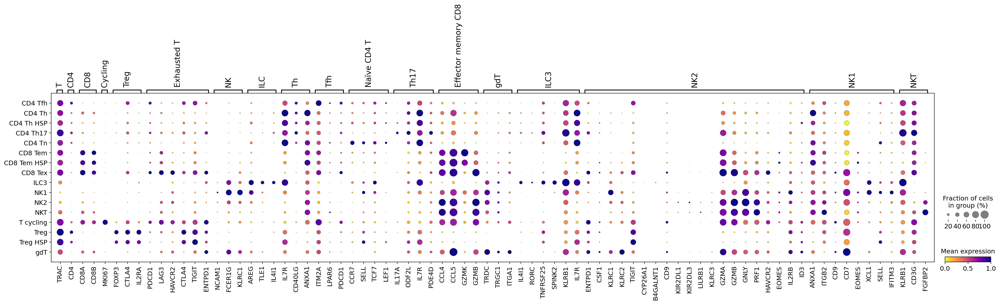

In [32]:
sc.pl.dotplot(
    adata_t,
    groupby="Annotation_scVI_detailed_NK",
    use_raw=True,
    var_names=markers,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="TNKILC_dotplot_mean_general_annotations.pdf",
    show=True,
)

In [33]:
# todo dotplot with all cell types annotated
markers_t = {
    "T": ["TRAC"],
    "CD4": ["CD4"],
    "CD8": ["CD8A", "CD8B"],
    "Cycling": ["MKI67"],
    "Treg": ["FOXP3", "CTLA4", "IL2RA"],
    "Exhausted T": [
        "PDCD1",
        "LAG3",
        "HAVCR2",
        "CTLA4",
        "TIGIT",
        "ENTPD1",
    ],  # PD1: PCDC1, TIM3: HAVCR2,  CD39:ENTPD1 https://www.nature.com/articles/s41467-021-23324-4
    "ILC": ["AREG", "TLE1", "IL4I1"],
    "Th": ["IL7R", "CD40LG", "ANXA1"],
    "Tfh": ["ITM2A", "LPAR6", "PDCD1"],
    "Naïve CD4 T": ["CCR7", "SELL", "TCF7", "LEF1"],
    "Th17": ["IL17A", "ODF2L", "IL7R", "PDE4D"],
    "Effector memory CD8": ["CCL4", "CCL5", "GZMK", "GZMB"],
    "gdT": ["TRDC", "TRGC1", "ITGA1"],
    "ILC3": ["IL4I1", "RORC", "TNFRSF25", "SPINK2", "KLRB1", "IL7R"],
}

markers_nk = {
    "NK": ["NCAM1", "FCER1G", "KLRC1"],
    "NK2": [
        "ENTPD1",
        "CSF1",
        "KLRC1",
        "KLRC2",
        "TIGIT",
        "CYP26A1",
        "B4GALNT1",
        "CD9",
        "KIR2DL1",
        "KIR2DL3",
        "LILRB1",
        "KLRC3",
        "GZMA",
        "GZMB",
        "GNLY",
        "PRF1",
        "HAVCR2",
        "EOMES",
        "IL2RB",
        "ID3",
    ],  # dNK1
    "NK1": ["ANXA1", "ITGB2", "CD9", "CD7", "EOMES", "XCL1", "SELL", "IFITM3"],  # dNK2
    "NKT": ["KLRB1", "CD3G", "FGFBP2"],
}

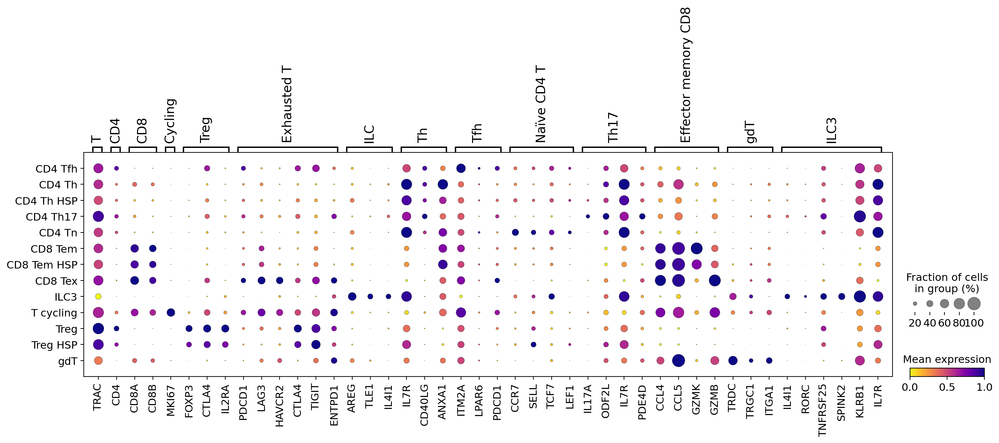

In [34]:
sc.pl.dotplot(
    adata_t[
        adata_t.obs.leiden_scVI != "6"
    ],  # all clusters except NK cluster, to plot T cell clusters only + ILC
    groupby="Annotation_scVI_detailed_NK",
    use_raw=True,
    var_names=markers_t,  # plot T cell clusters only
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="TNKILC_dotplot_mean_Tmarkers.pdf",
    show=True,
)

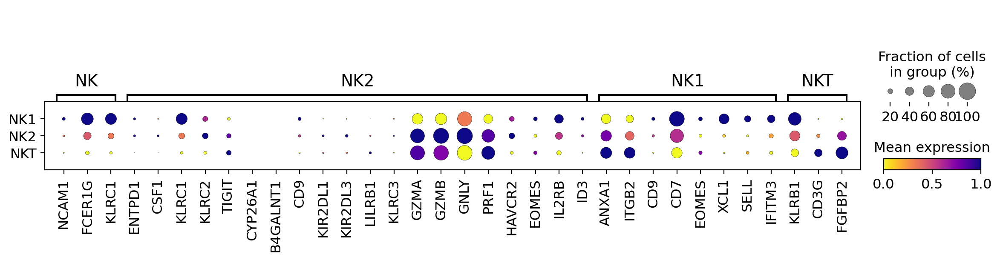

In [35]:
sc.pl.dotplot(
    adata_t[
        adata_t.obs.leiden_scVI == "6"
    ],  # only NK cluster, to plot NK cell clusters only + NKT
    groupby="Annotation_scVI_detailed_NK",
    use_raw=True,
    var_names=markers_nk,  # plot NK cell clusters only
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="TNKILC_dotplot_mean_NKmarkers.pdf",
    show=True,
)

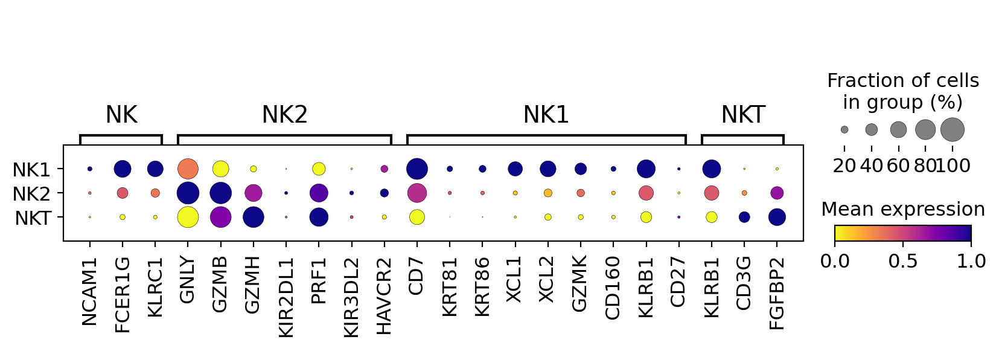

In [36]:
markers_nk_selected = {
    "NK": ["NCAM1", "FCER1G", "KLRC1"],
    "NK2": ["GNLY", "GZMB", "GZMH", "KIR2DL1", "PRF1", "KIR3DL2", "HAVCR2"],  # dNK1
    "NK1": [
        "CD7",
        "KRT81",
        "KRT86",
        "XCL1",
        "XCL2",
        "GZMK",
        "CD160",
        "KLRB1",
        "CD27",
    ],  # dNK2
    "NKT": ["KLRB1", "CD3G", "FGFBP2"],
}

sc.pl.dotplot(
    adata_t[
        adata_t.obs.leiden_scVI == "6"
    ],  # only NK cluster, to plot NK cell clusters only + NKT
    groupby="Annotation_scVI_detailed_NK",
    use_raw=True,
    var_names=markers_nk_selected,  # plot NK cell clusters only
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="TNKILC_dotplot_mean_NKmarkers_selected.pdf",
    show=True,
)

In [37]:
# drop Annotation_scVI_detailed
adata_t.obs.drop(labels="Annotation_scVI_detailed", axis=1, inplace=True)

# rename Annotation_scVI_NK to Annotation_scVI_detailed
adata_t.obs.rename(
    columns={"Annotation_scVI_detailed_NK": "Annotation_scVI_detailed"}, inplace=True
)

In [38]:
adata_t.obs

,Patient,Sample,Cell_type,Cell_subtype,Tissue,Therapy,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,...,CD8_HSP_score,Trm_XCL1_score,CD8_Te_GZMK_score,CD4_Tn_score,CD4_Treg_score,S_score,G2M_score,phase,cell_cycle_diff,Annotation_scVI_detailed
SMC03-T_ATCTACTGTCATGCCG-SMC,SMC03,SMC03-T,Epithelial cells,CMS3,CRC,naive,0.043597,False,402,1110.0,...,0.615499,0.076110,-0.016716,0.025334,0.143422,-0.067636,-0.067099,G1,-0.000537,CD4 Th HSP
SMC14-T_CACAGGCCAGACACTT-SMC,SMC14,SMC14-T,Epithelial cells,CMS2,CRC,naive,0.145401,False,1087,1965.0,...,0.450330,0.197353,0.019614,-0.032252,0.242251,-0.167812,0.008236,G2M,-0.176048,Treg HSP
SMC01-T_AAACCTGAGAAGGTTT-SMC,SMC01,SMC01-T,T cells,Regulatory T cells,CRC,naive,0.026052,False,1421,3400.0,...,0.408916,0.250106,0.448913,0.369975,0.820650,-0.089521,0.092221,G2M,-0.181742,Treg
SMC01-T_AAACCTGAGGTAGCTG-SMC,SMC01,SMC01-T,T cells,Unknown,CRC,naive,0.080725,False,1270,4495.0,...,0.604204,0.260866,0.418023,0.514314,0.559388,-0.100857,-0.081618,G1,-0.019239,CD4 Th
SMC01-T_AAACCTGGTCATATCG-SMC,SMC01,SMC01-T,T cells,Regulatory T cells,CRC,naive,0.057851,False,738,1889.0,...,0.288625,0.127625,0.358782,0.309141,0.529115,-0.082524,0.010065,G2M,-0.092588,Treg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P17_Colon_T_TTGTTTGCAGCTGTCG-1-Wu,Wu2021_P17,P17_Colon_T,CD4,CD4+ Naive T cells,CRC,naive,0.375723,False,526,1189.0,...,0.497492,0.180618,0.267155,0.501348,0.189177,-0.093882,-0.041460,G1,-0.052423,CD4 Th HSP
P17_Colon_T_TTTATGCCACTTCATT-1-Wu,Wu2021_P17,P17_Colon_T,CD4,CD4+ Naive T cells,CRC,naive,0.116822,False,320,618.0,...,0.092408,0.064462,0.228368,0.100129,0.183096,-0.056839,-0.056388,G1,-0.000451,CD4 Tn
P17_Colon_T_TTTCACACACACCTGG-1-Wu,Wu2021_P17,P17_Colon_T,CD8,FGFBP2+ GZMB+ CD8+ T cells,CRC,naive,0.074468,False,369,617.0,...,0.506961,0.125624,0.496340,0.070080,0.182674,-0.088863,-0.088158,G1,-0.000705,CD8 Tem
P17_Colon_T_TTTCACAGTACGACTT-1-Wu,Wu2021_P17,P17_Colon_T,CD8,XCL1+ CD8+ T cells,CRC,naive,0.124088,False,586,1196.0,...,0.818976,0.363183,0.265698,0.241333,0.256069,0.048652,0.089048,G2M,-0.040396,CD4 Th


In [39]:
adata_t.uns["Annotation_scVI_detailed_colors"] = adata_t.uns[
    "Annotation_scVI_detailed_NK_colors"
]

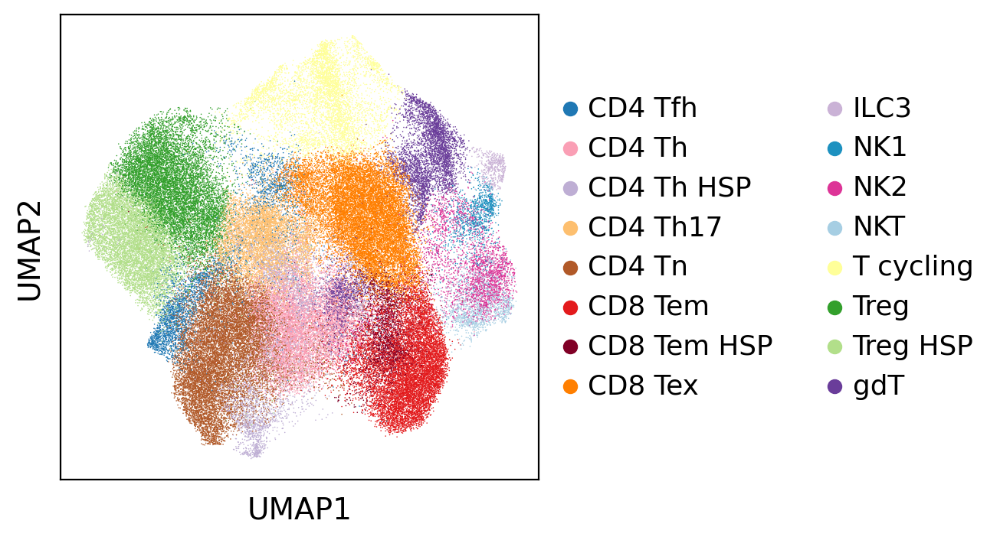

In [40]:
sc.pl.umap(
    adata_t,
    color="Annotation_scVI_detailed",
    show=True,
    legend_loc="right margin",
    title="",
)

In [41]:
# save object
# write to file
adata_t.write(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_TNKILC_final.h5ad")
)

In [4]:
adata_t = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_TNKILC_final.h5ad")
)

In [5]:
adata_t.shape

(94164, 2000)

In [7]:
adata_t.obs.Annotation_scVI_detailed.value_counts()

CD8 Tex        13813
CD4 Tn         12862
CD8 Tem        10033
Treg            9747
CD4 Th          8345
Treg HSP        7770
CD4 Th17        6170
T cycling       5220
gdT             4972
CD4 Th HSP      3611
CD4 Tfh         3470
NK2             2840
CD8 Tem HSP     2306
NKT             1449
NK1             1088
ILC3             468
Name: Annotation_scVI_detailed, dtype: int64

#### Barplots chemotreated vs naive in metastasis 

In [43]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, plot2save, colors: dict
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1, ncols=1, sharey=False, sharex=False, dpi=DPI
    )  # , figsize=(4, 4))

    print(table2plot)

    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors

    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())

    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]

    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(
        plot2save,
        dpi=DPI,
        format="png",
        facecolor="w",
        transparent=True,
        edgecolor="w",
        # orientation='landscape'
    )

    plt.show()

In [44]:
adata_t.obs["Annotation_scVI_detailed"]

SMC03-T_ATCTACTGTCATGCCG-SMC         CD4 Th HSP
SMC14-T_CACAGGCCAGACACTT-SMC           Treg HSP
SMC01-T_AAACCTGAGAAGGTTT-SMC               Treg
SMC01-T_AAACCTGAGGTAGCTG-SMC             CD4 Th
SMC01-T_AAACCTGGTCATATCG-SMC               Treg
                                        ...    
P17_Colon_T_TTGTTTGCAGCTGTCG-1-Wu    CD4 Th HSP
P17_Colon_T_TTTATGCCACTTCATT-1-Wu        CD4 Tn
P17_Colon_T_TTTCACACACACCTGG-1-Wu       CD8 Tem
P17_Colon_T_TTTCACAGTACGACTT-1-Wu        CD4 Th
P17_Colon_T_TTTCATGCACACAGAG-1-Wu        CD4 Th
Name: Annotation_scVI_detailed, Length: 94164, dtype: category
Categories (16, object): ['CD4 Tfh', 'CD4 Th', 'CD4 Th HSP', 'CD4 Th17', ..., 'T cycling', 'Treg', 'Treg HSP', 'gdT']

In [45]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata_t.obs["Annotation_scVI_detailed"].cat.categories.values.tolist(),
        adata_t.uns["Annotation_scVI_detailed_colors"],
    )
)

Annotation_scVI_detailed   CD4 Tfh    CD4 Th  CD4 Th HSP  CD4 Th17     CD4 Tn  \
Therapy                                                                         
NAC                       3.053435  7.172940    5.619900  5.560674  20.880495   
naive                     3.806605  9.187266    3.491288  6.743238  12.269527   

Annotation_scVI_detailed    CD8 Tem  CD8 Tem HSP    CD8 Tex      ILC3  \
Therapy                                                                 
NAC                       16.517505     1.717557   1.572782  0.585680   
naive                      9.526644     2.589657  17.189241  0.479941   

Annotation_scVI_detailed       NK1       NK2       NKT  T cycling       Treg  \
Therapy                                                                        
NAC                       0.888392  3.237694  1.914978   2.250592  11.029218   
naive                     1.206818  2.973356  1.466417   6.177186  10.220596   

Annotation_scVI_detailed   Treg HSP       gdT  
Therapy      

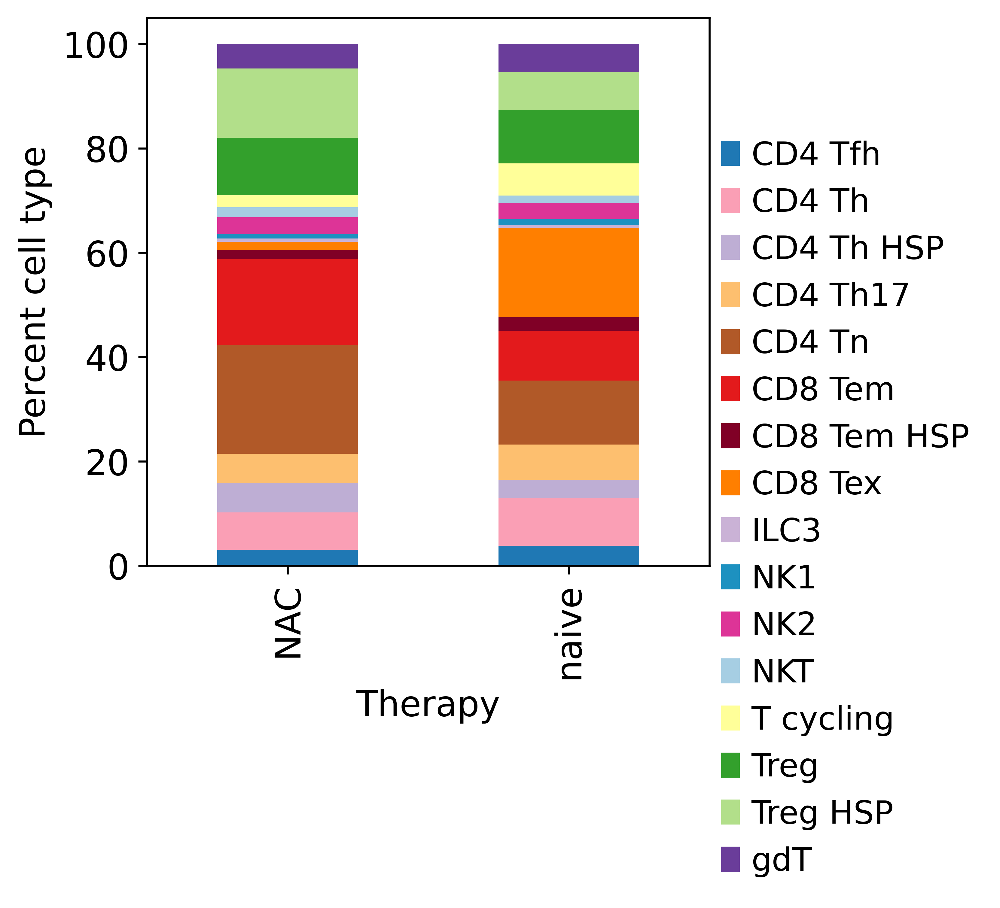

In [46]:
proportion_cells_patient(
    adata_t.obs,
    groupby_labels=["Therapy", "Annotation_scVI_detailed"],
    xlabel="Therapy",
    ylabel="Percent cell type",
    colors=color_dict,
    plot2save=FIG2SAVE.joinpath("Barplot_therapy_celltypes.png"),
)

In [47]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, colors: dict, figname: str
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        sharey=False,
        sharex=False,
        dpi=DPI,
    )  # figsize=(4, 4))

    print(table2plot)
    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())
    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]
    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(FIG2SAVE.joinpath(figname), dpi=DPI, format="pdf", bbox_inches="tight")
    plt.show()

cell_source                     SMC       KUL      Pelka        Che         Wu
Annotation_scVI_detailed                                                      
CD4 Tfh                   13.919308  2.968300  39.711816  30.144092  13.256484
CD4 Th                     9.119233  3.271420  45.200719  28.208508  14.200120
CD4 Th HSP                23.566879  0.138466   7.366381  10.495708  58.432567
CD4 Th17                  26.337115  1.539708  42.512156  13.225284  16.385737
CD4 Tn                    23.207899  2.589022  25.260457  25.610325  23.332297
CD8 Tem                   18.788000  2.491777  17.990631  44.303797  16.425795
CD8 Tem HSP               25.411969  0.910668  30.095403  16.261925  27.320035
CD8 Tex                   14.001303  0.767393  67.125172  12.727141   5.378991
ILC3                      15.811966  2.564103  55.341880  19.658120   6.623932
NK1                       19.944853  2.297794  44.025735  26.286765   7.444853
NK2                       16.514085  0.563380  33.52

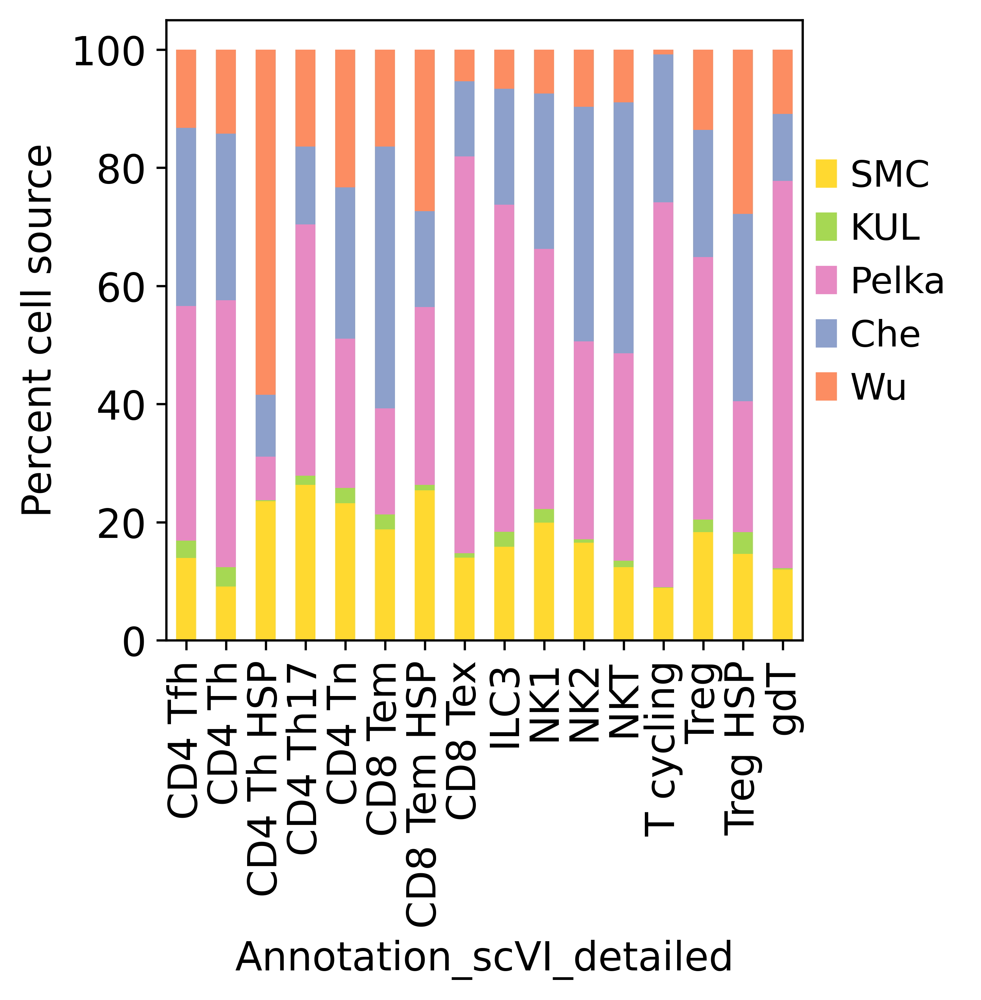

In [48]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata_t.obs["cell_source"].cat.categories.values.tolist(),
        adata_t.uns["cell_source_colors"],
    )
)

proportion_cells_patient(
    adata_t.obs,
    groupby_labels=["Annotation_scVI_detailed", "cell_source"],
    xlabel="Annotation_scVI_detailed",
    ylabel="Percent cell source",
    colors=color_dict,
    figname="leiden_cell_source.pdf",
)

In [5]:
adata_t = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_TNKILC_final.h5ad")
)

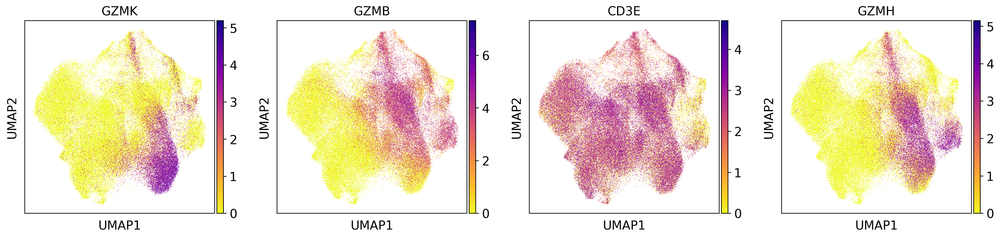

In [7]:
sc.pl.umap(
    adata_t, color=["GZMK", "GZMB", "CD3E", "GZMH"], use_raw=True, color_map="plasma_r", save="GZMB_CD3E.pdf"
)

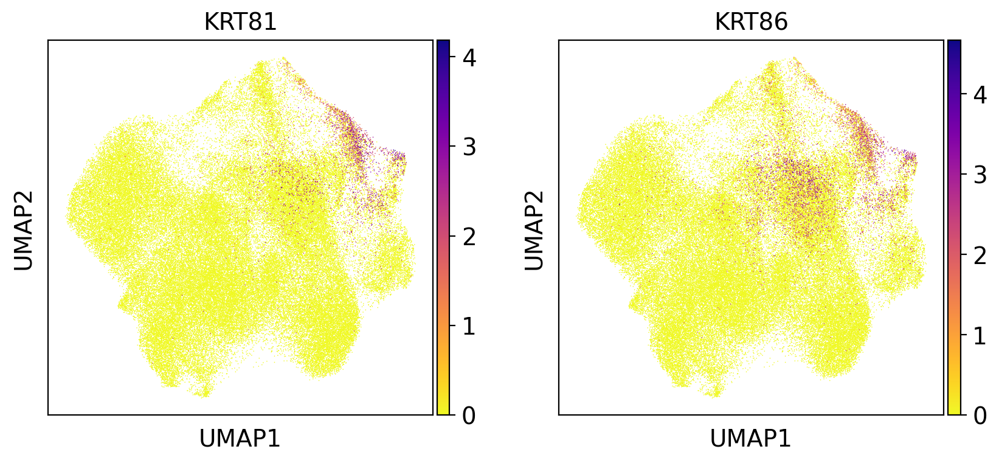

In [8]:
sc.pl.umap(
    adata_t, color=["KRT81", "KRT86"], use_raw=True, color_map="plasma_r", save="KRT81_86.pdf"
)